<a href="https://colab.research.google.com/github/ZongoSosthene/PROJET_DDEFI_2025/blob/main/visualisation_data_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<u><h1 style='text-align: center;'>Notebook - Jeu de données sur Parcoursup</h1></u>

<h3 style='text-align: center;'>Yohann LE COUSTER - Cédric LOUSSERT - Sosthene ZONGO</h3>
<h4 style='text-align: center;'>ADAD - DDEFi - 3A</h4>

<u><h2 style='color: black;'>1. Importation sous forme de DataFrame</h1></u>

In [ ]:
import pandas as pd
import seaborn as sns
import numpy as np
from IPython.display import display
import matplotlib.pyplot as plt

# URL du fichier CSV
url = "https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup/exports/csv?lang=fr&timezone=Europe%2FBerlin&use_labels=true&delimiter=%3B"

# Chargement du fichier CSV depuis l'URL
df = pd.read_csv(url, sep=";")


# Affichage du DataFrame
#display(df)

In [ ]:
url_2022= "https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup_2022/exports/csv?use_labels=true"

df_2022 = pd.read_csv(url_2022, sep=";")

display(df_2022)


In [ ]:
list_url = ["https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup-2019/exports/csv?use_labels=true","https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup_2020/exports/csv?use_labels=true","https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup_2021/exports/csv?use_labels=true", "https://data.enseignementsup-recherche.gouv.fr/api/explore/v2.1/catalog/datasets/fr-esr-parcoursup_2022/exports/csv?use_labels=true"]
i = 0
for elt in list_url:
    df_temp = pd.read_csv(elt, sep=";")
    #df = pd.concat([df, df_temp])
    print(list(df_temp.columns.values))
    i += 1
    print ("that was for",i)



['Session', 'Statut de l’établissement de la filière de formation (public, privé…)', "Code UAI de l'établissement", 'Établissement', 'Code départemental de l’établissement', 'Département de l’établissement', 'Région de l’établissement', 'Académie de l’établissement', 'Filière de formation très agrégée', 'Filière de formation', "Concours communs et banques d'épreuves", 'Filière de formation détaillée', 'Filière de formation très détaillée', 'Lien de la formation sur la plateforme Parcoursup', 'Coordonnées GPS de la formation', 'Capacité de l’établissement par formation', 'Effectif total des candidats pour une formation', 'Dont effectif des candidates pour une formation', 'Effectif total des candidats en phase principale', 'Dont effectif des candidats ayant postulé en internat', 'Effectif des candidats néo bacheliers généraux en phase principale', 'Dont effectif des candidats boursiers néo bacheliers généraux en phase principale', 'Effectif des candidats néo bacheliers technologiques en 

In [ ]:
list(df.columns.values)

['Session',
 'Statut de l’établissement de la filière de formation (public, privé…)',
 "Code UAI de l'établissement",
 'Établissement',
 'Code départemental de l’établissement',
 'Département de l’établissement',
 'Région de l’établissement',
 'Académie de l’établissement',
 'Commune de l’établissement',
 'Filière de formation',
 'Sélectivité',
 'Filière de formation très agrégée',
 'Filière de formation détaillée',
 'Filière de formation.1',
 'Filière de formation détaillée bis',
 'Filière de formation très détaillée',
 'Coordonnées GPS de la formation',
 'Capacité de l’établissement par formation',
 'Effectif total des candidats pour une formation',
 'Dont effectif des candidates pour une formation',
 'Effectif total des candidats en phase principale',
 'Dont effectif des candidats ayant postulé en internat',
 'Effectif des candidats néo bacheliers généraux en phase principale',
 'Dont effectif des candidats boursiers néo bacheliers généraux en phase principale',
 'Effectif des candi

<u><h2 style='color: black;'>2. Analyse : Répartition des candidats admis par type de bacs</h1></u>

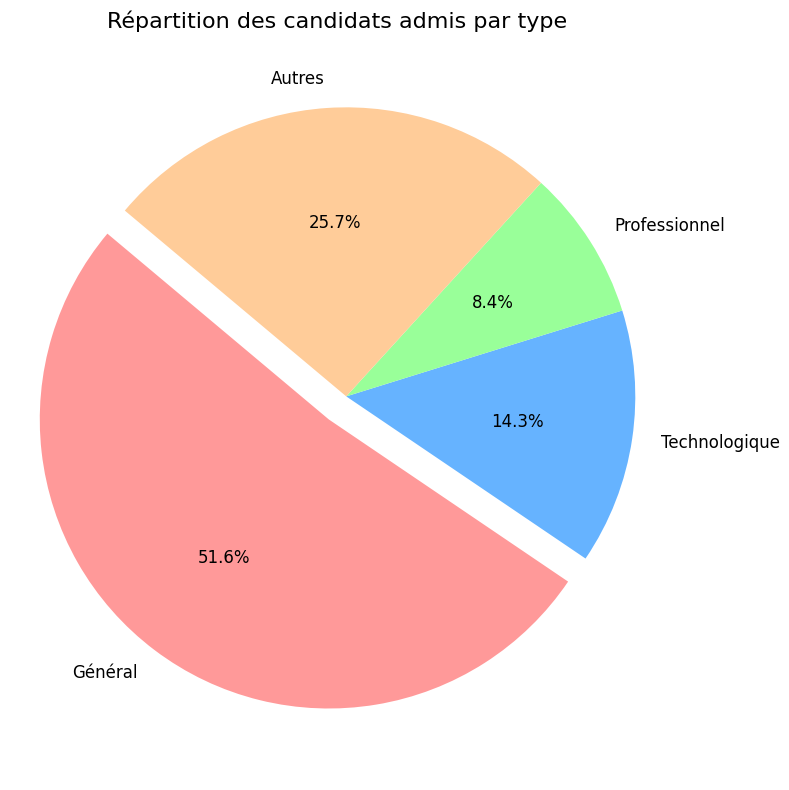

In [ ]:
# Calcul des effectifs totaux pour chaque type d'admis
admis_types = {
    "Général": df["Effectif des admis néo bacheliers généraux"].sum(),
    "Technologique": df["Effectif des admis néo bacheliers technologiques"].sum(),
    "Professionnel": df["Effectif des admis néo bacheliers professionnels"].sum(),
    "Autres": df["Effectif des autres candidats admis"].sum()
}

# Conversion en DataFrame
admis_df = pd.DataFrame(list(admis_types.items()), columns=["Type de candidat", "Effectif"])

# Préparation des données pour le camembert
labels = admis_df["Type de candidat"]
sizes = admis_df["Effectif"]
colors = ["#ff9999", "#66b3ff", "#99ff99", "#ffcc99"]  # Palette de couleurs personnalisée
explode = (0.1, 0, 0, 0)  # Mettre en avant la première catégorie (par exemple "Général")

# Création du graphique
plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, colors=colors, explode=explode, textprops={"fontsize": 12})
plt.title("Répartition des candidats admis par type", fontsize=16)
plt.axis('equal')  # Assure que le camembert est circulaire
plt.tight_layout()
plt.show()

<u><h2 style='color: black;'>3. Analyse : Nombre de formations sélectives et non sélectives en fonction de la région</h1></u>

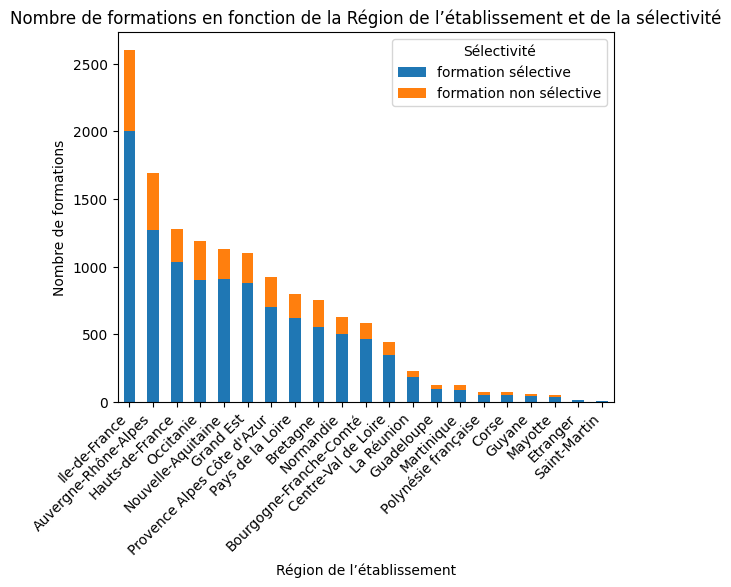

In [ ]:
# Group the data and unstack it
count_data = df.groupby(['Région de l’établissement', 'Sélectivité']).size().unstack(fill_value=0)

# Calculate the total values for sorting
count_data['Total'] = count_data.sum(axis=1)

# Sort the values in descending order based on the total values
count_data = count_data.sort_values(by='Total', ascending=False).drop(columns=['Total'])

# Reorder the columns to reverse the order of 'Sélectivité' categories
count_data = count_data[count_data.columns[::-1]]

# Plot the stacked bar chart with different colors for each 'Sélectivité' category
ax = count_data.plot(kind='bar', stacked=True)

# Customize the plot
plt.xticks(rotation=45, ha='right')  # Set the rotation to 45 degrees and align the text to the right
plt.xlabel('Région de l’établissement')
plt.ylabel('Nombre de formations')
plt.title('Nombre de formations en fonction de la Région de l’établissement et de la sélectivité')

# Add a legend
plt.legend(title='Sélectivité')

# Show the plot
plt.show()

<u><h2 style='color: black;'>4. Analyse : Admission des filles dans les filières représenté sous forme de distribution</h1></u>

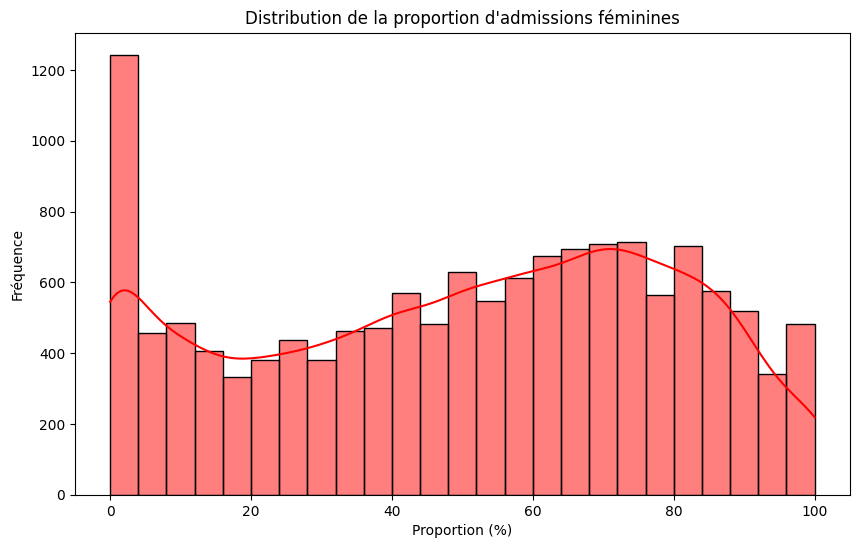

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df['% d’admis dont filles'], kde=True, color='red')
plt.title("Distribution de la proportion d'admissions féminines")
plt.xlabel("Proportion (%)")
plt.ylabel("Fréquence")
plt.show()

<u><h2 style='color: black;'>5. Analyse : Représentation du taux d'admission des boursiers par types de bacs</h2></u>

/var/folders/80/64704ns17nv00bj59snn041c0000gn/T/ipykernel_874/1817718272.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=boursiers_df, x="Type de Bac", y="Effectif Boursiers Admis", palette="viridis")


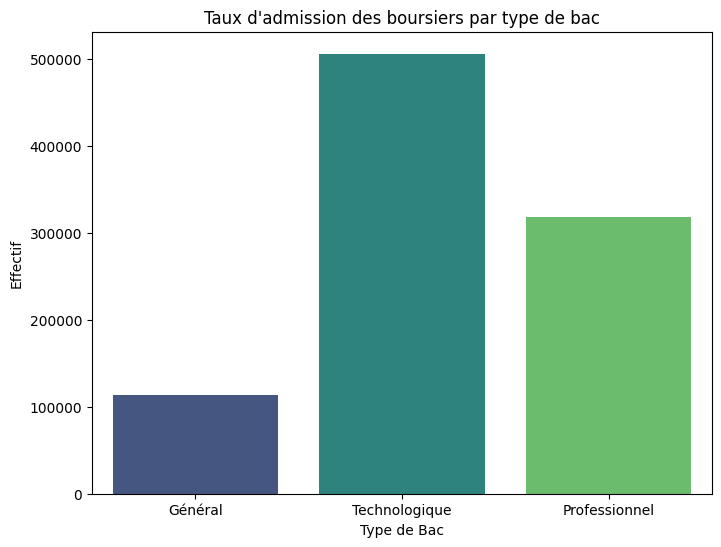

In [ ]:
# Calcul des taux d'admission des boursiers
boursiers_admis = {
    "Général": df["Dont effectif des admis boursiers néo bacheliers"].sum(),
    "Technologique": df["Dont effectif des candidats boursiers néo bacheliers technologiques en phase principale"].sum(),
    "Professionnel": df["Dont effectif des candidats boursiers néo bacheliers professionnels en phase principale"].sum()
}

# Conversion en DataFrame
boursiers_df = pd.DataFrame(list(boursiers_admis.items()), columns=["Type de Bac", "Effectif Boursiers Admis"])

# Barplot
plt.figure(figsize=(8, 6))
sns.barplot(data=boursiers_df, x="Type de Bac", y="Effectif Boursiers Admis", palette="viridis")
plt.title("Taux d'admission des boursiers par type de bac")
plt.xlabel("Type de Bac")
plt.ylabel("Effectif")
plt.show()


<u><h2 style='color: black;'>6. Analyse : Représentation de la proportion des boursiers parmi les néo-bacheliers admis par région</h2></u>

/var/folders/80/64704ns17nv00bj59snn041c0000gn/T/ipykernel_874/741408790.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=region_analysis_sorted.index, y=region_analysis_sorted['Proportion_boursiers'], palette='Blues_d')


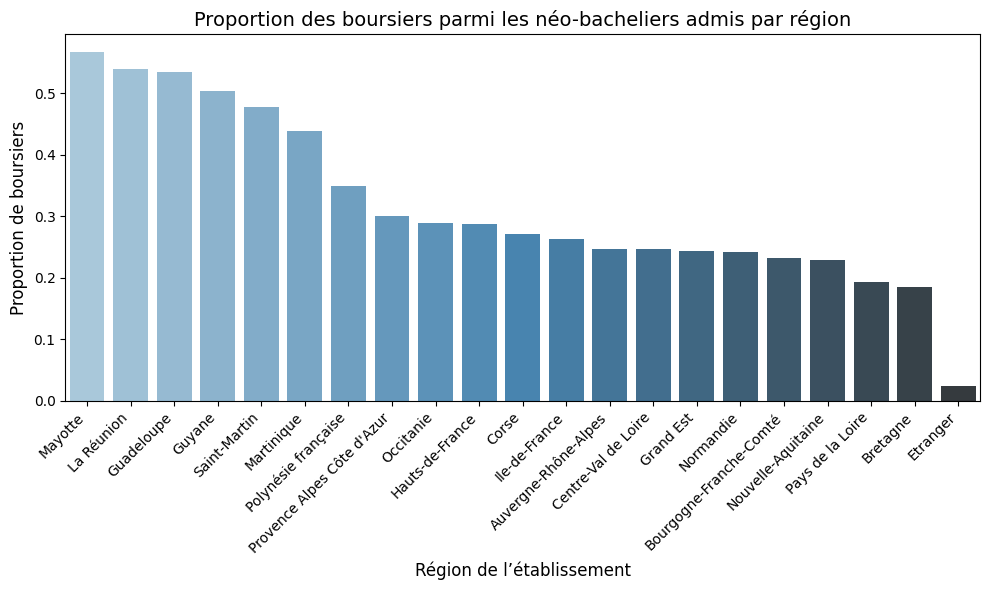

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calcul de la proportion de boursiers parmi les néo-bacheliers admis par région
df['Proportion_boursiers'] = df['Dont effectif des admis boursiers néo bacheliers'] / df['Effectif des admis néo bacheliers']

# Analyse par région
region_analysis = df.groupby('Région de l’établissement')[['Proportion_boursiers']].mean()

# Trier par ordre décroissant de la proportion de boursiers
region_analysis_sorted = region_analysis.sort_values(by='Proportion_boursiers', ascending=False)

# Configuration des paramètres visuels
plt.figure(figsize=(10, 6))
sns.barplot(x=region_analysis_sorted.index, y=region_analysis_sorted['Proportion_boursiers'], palette='Blues_d')

# Ajouter des titres et des labels
plt.title("Proportion des boursiers parmi les néo-bacheliers admis par région", fontsize=14)
plt.xlabel("Région de l’établissement", fontsize=12)
plt.ylabel("Proportion de boursiers", fontsize=12)
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()

# Afficher le graphique
plt.show()


<u><h2 style='color: black;'>7. Analyse : Représentation de la proportion d'admis boursiers parmi les néo-bacheliers par filière de formation très agrégée en France</h2></u>

/var/folders/80/64704ns17nv00bj59snn041c0000gn/T/ipykernel_874/555716480.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=filière_agrégée_analysis_sorted.index, y=filière_agrégée_analysis_sorted['Proportion_boursiers_filière_agrégée'], palette='viridis')


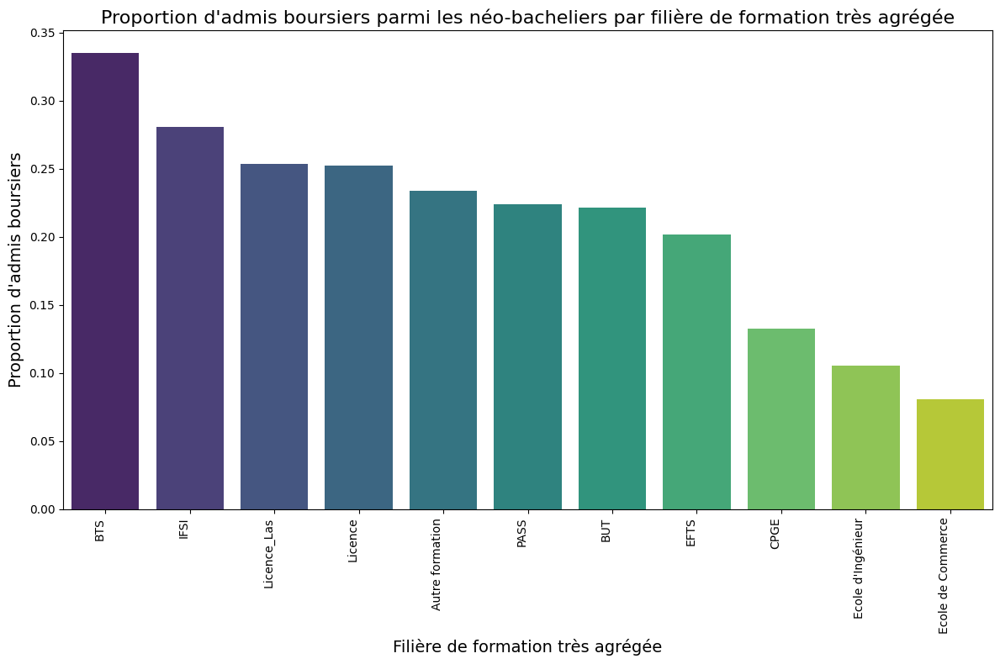

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calcul de la proportion d'admis boursiers parmi les néo-bacheliers par filière très agrégée
df['Proportion_boursiers_filière_agrégée'] = df['Dont effectif des admis boursiers néo bacheliers'] / df['Effectif des admis néo bacheliers']

# Analyse par filière de formation très agrégée
filière_agrégée_analysis = df.groupby('Filière de formation très agrégée')[['Proportion_boursiers_filière_agrégée']].mean()

# Trier par ordre décroissant de la proportion d'admis boursiers
filière_agrégée_analysis_sorted = filière_agrégée_analysis.sort_values(by='Proportion_boursiers_filière_agrégée', ascending=False)

# Configuration des paramètres visuels
plt.figure(figsize=(12, 8))
sns.barplot(x=filière_agrégée_analysis_sorted.index, y=filière_agrégée_analysis_sorted['Proportion_boursiers_filière_agrégée'], palette='viridis')

# Ajouter des titres et des labels
plt.title("Proportion d'admis boursiers parmi les néo-bacheliers par filière de formation très agrégée", fontsize=16)
plt.xlabel("Filière de formation très agrégée", fontsize=14)
plt.ylabel("Proportion d'admis boursiers", fontsize=14)
plt.xticks(rotation=90, ha="right", fontsize=10)
plt.tight_layout()

# Afficher le graphique
plt.show()


<u><h2 style='color: black;'>8. Analyse : Représentation de la proportion d'admis boursiers et par régions</h2></u>

In [ ]:
import pandas as pd
import dash
from dash import dcc, html, Input, Output
import plotly.express as px

# Création d'une application Dash
app = dash.Dash(__name__)

# Préparer les données (exemple de DataFrame)
# df = pd.read_csv("votre_fichier.csv") # Chargez vos données ici
df['Proportion_boursiers_filière_agrégée'] = (
    df['Dont effectif des admis boursiers néo bacheliers'] /
    df['Effectif des admis néo bacheliers']
)

# Liste des régions disponibles
regions = df['Région de l’établissement'].unique()
regions = ['France'] + list(regions)  # Ajouter "France" pour l'ensemble des régions

# Application Layout
app.layout = html.Div([
    html.H1("Proportion d'admis boursiers par filière et par région", style={'text-align': 'center'}),

    # Dropdown pour sélectionner une région
    dcc.Dropdown(
        id='region-selector',
        options=[{'label': region, 'value': region} for region in regions],
        value='France',  # Région par défaut
        placeholder="Sélectionnez une région",
        style={'width': '50%', 'margin': 'auto'}
    ),

    # Graphique interactif
    dcc.Graph(id='boursiers-graph')
])

# Callback pour mettre à jour le graphique en fonction de la région sélectionnée
@app.callback(
    Output('boursiers-graph', 'figure'),
    [Input('region-selector', 'value')]
)
def update_graph(selected_region):
    if selected_region == 'France':
        filtered_df = df
    else:
        filtered_df = df[df['Région de l’établissement'] == selected_region]

    # Calcul de la proportion moyenne par filière
    filière_agrégée_analysis = (
        filtered_df.groupby('Filière de formation très agrégée')[['Proportion_boursiers_filière_agrégée']]
        .mean()
        .sort_values(by='Proportion_boursiers_filière_agrégée', ascending=False)
    ).reset_index()

    # Créer un graphique interactif avec Plotly
    fig = px.bar(
        filière_agrégée_analysis,
        x='Filière de formation très agrégée',
        y='Proportion_boursiers_filière_agrégée',
        title=f"Proportion d'admis boursiers par filière ({selected_region})",
        labels={'Proportion_boursiers_filière_agrégée': 'Proportion d’admis boursiers'},
        color='Proportion_boursiers_filière_agrégée',
        color_continuous_scale='viridis'
    )
    fig.update_layout(xaxis_title="Filière de formation très agrégée", yaxis_title="Proportion d'admis boursiers")
    return fig

# Lancer l'application
if __name__ == '__main__':
    app.run_server(debug=False)


<u><h2 style='color: black;'>9. Analyse : Représentation des formations sur une carte de France (avec la bibliothèque folium sur Python)</h2></u>

In [ ]:
import folium
from IPython.display import display
import matplotlib.pyplot as plt

# Générer une liste de couleurs distinctes pour les régions
if 'Région de l’établissement' in df.columns:
    regions = df['Région de l’établissement'].unique()
    colors = plt.cm.tab20.colors  # Palette de 20 couleurs
    region_colors = {region: f"#{int(r*255):02x}{int(g*255):02x}{int(b*255):02x}" for region, (r, g, b) in zip(regions, colors)}

    # Vérifie que la colonne 'Coordonnées GPS de la formation' existe
    if 'Coordonnées GPS de la formation' in df.columns:
        # Filtrer les lignes avec des coordonnées GPS valides
        df = df[df['Coordonnées GPS de la formation'].notna()]
        df[['Latitude', 'Longitude']] = df['Coordonnées GPS de la formation'].str.split(', ', expand=True)
        df['Latitude'] = df['Latitude'].astype(float)
        df['Longitude'] = df['Longitude'].astype(float)

        # Créer une carte centrée sur la France
        france_map = folium.Map(location=[46.603354, 1.888334], zoom_start=6)

        # Ajouter les points sur la carte avec des couleurs en fonction des régions
        for _, row in df.iterrows():
            region = row['Région de l’établissement']
            color = region_colors.get(region, '#000000')  # Noir par défaut si région absente
            établissement = row.get('Établissement', 'Établissement inconnu')  # Nom de l'établissement

            # Ajouter un point avec popup cliquable
            folium.CircleMarker(
                location=(row['Latitude'], row['Longitude']),
                radius=5,  # Taille du point
                color=color,
                fill=True,
                fill_color=color,
                fill_opacity=0.7,
                popup=folium.Popup(f"<b>{établissement}</b>", max_width=300)
            ).add_to(france_map)

        # Afficher la carte dans le notebook
        display(france_map)
    else:
        print("La colonne 'Coordonnées GPS de la formation' est manquante dans le DataFrame.")
else:
    print("La colonne 'Région de l’établissement' est manquante dans le DataFrame.")
